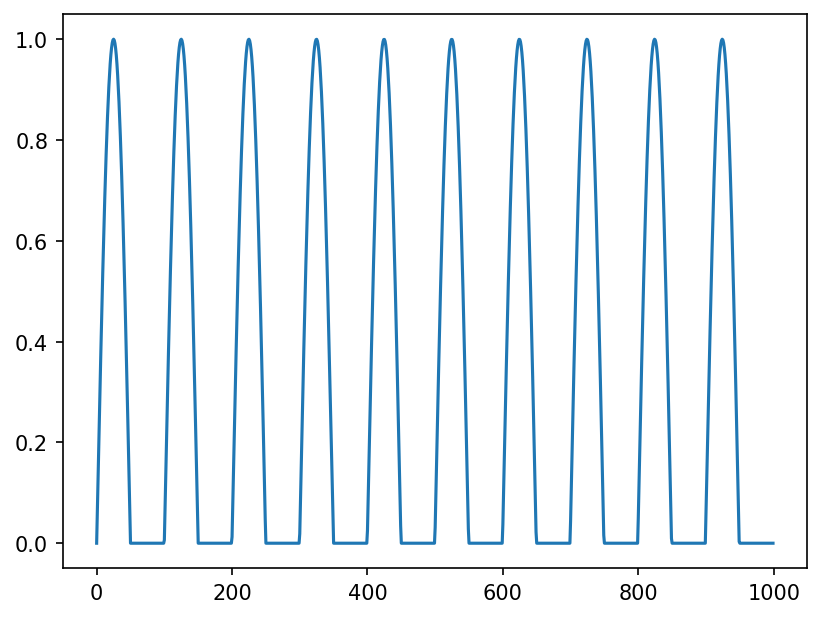

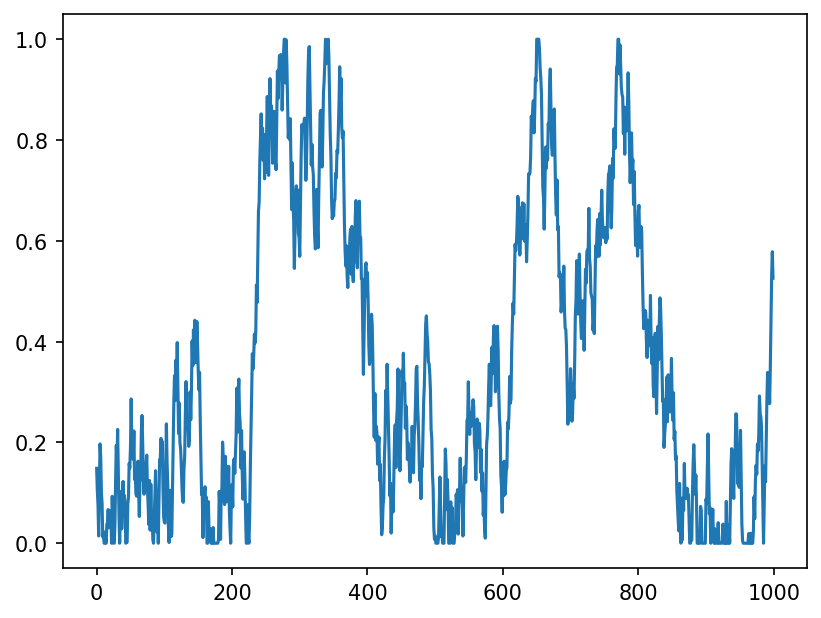

In [5]:
import numpy as np
import matplotlib.pyplot as plt
plt.close()

def generate_speed_profile(n, amplitude=1, frequency=2):
    time_points = np.linspace(0, 2 * np.pi, n)
    speed_profile = amplitude * np.sin(frequency * time_points)
    speed_profile = np.clip(speed_profile, a_min=0, a_max=None)
    return speed_profile

def generate_random_walk_speed_profile(num_samples):
    speeds = np.zeros(num_samples)
    speeds[0] = np.random.rand()  # Start with a random speed between 0 and 1
    for i in range(1, num_samples):
        step = np.random.uniform(-0.1, 0.1)  # Adjust step size as needed
        speeds[i] = speeds[i-1] + step
        speeds[i] = np.clip(speeds[i], 0, 1)
    return speeds


# Example usage
n = 1000
speed_profile = generate_speed_profile(n, frequency=10)
plt.plot(speed_profile)
plt.show()

# Example usage
num_samples = 1000
speed_profile = generate_random_walk_speed_profile(num_samples)
plt.plot(speed_profile)
plt.show()



In [2]:
import math

def calculate_next_position(pos, angle_deg, speed):
    angle_rad = np.deg2rad(angle_deg)
    #print(f"deg is {angle_deg}")
    #print(f"rad is {angle_rad}")
    x, y = pos[0], pos[1]
    delta_x = speed * math.cos(angle_rad)
    delta_y = speed * math.sin(angle_rad)
    new_x = x + delta_x
    new_y = y + delta_y
    new_pos = np.array([new_x, new_y])
    return new_pos

def add_gaussian_noise(a, mean=0, std_dev=5, clip=True):
    noise = np.random.normal(mean, std_dev)
    if clip:
        noise = np.clip(a, a_min=-std_dev, a_max=std_dev)
    return a + noise

In [6]:
np.random.seed(2)

import matplotlib.animation
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches
import numpy.random as random
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()
ax.set_xlim(0, 10)
ax.set_ylim(0, 10)
rect = patches.Rectangle((0, 0), 10, 10, linewidth=1, edgecolor='b', facecolor='none')
ax.add_patch(rect)
pos = np.array([5,5], dtype=np.float128)
angle_of_travel = np.random.uniform(low=0, high=360)
#print(angle_of_travel)
n_frames = len(speed_profile)
input_speed = speed_profile
positions = np.zeros((n_frames, 2)); positions[:] = np.nan


def animate(t):
    plt.cla()
    global pos, angle_of_travel, input_speed
    
    plt.scatter(x=pos[0], y=pos[1], s=40, marker="o")

    positions[t, :] = pos
    plt.plot(positions[:,0], positions[:, 1])
    plt.xlim(-1,11)
    plt.ylim(-1,11)
    rect = patches.Rectangle((0, 0), 10, 10, linewidth=1, edgecolor='b', facecolor='none')
    ax.add_patch(rect)

    # Check for collision with walls and reflect the velocity
    if (pos[0] <= 0) or (pos[0] >= 10): # left wall#        
        angle_of_travel = 180-angle_of_travel
        angle_of_travel = add_gaussian_noise(angle_of_travel)
    elif (pos[1] <= 0) or (pos[1] >= 10): # right wall
        angle_of_travel = -angle_of_travel
        angle_of_travel = add_gaussian_noise(angle_of_travel)

    pos = calculate_next_position(pos, angle_of_travel, input_speed[t])

matplotlib.animation.FuncAnimation(fig, animate, frames=n_frames)



Animation size has reached 21060495 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
